# Spectrum

In [2]:
# Librerías estándar y de terceros
import os
import sys
import gc
import math as m
import numpy as np
import scipy
import pandas as pd
from scipy import *
from scipy.signal import butter, filtfilt, hilbert
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from matplotlib import pyplot as plt
from my_funcs import *
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
from matplotlib.ticker import MaxNLocator

<function my_funcs.spectrum_integration(eta, N, L, CHECK=False)>

In [ ]:
# Configuración de rutas para importaciones personalizadas
sys.path.append("/projects/DEIKE/cmartinb/jupyter_notebook/project_specific/turbulence")

# Funciones y clases personalizadas
from funciones import *  # Asegúrate de que la importación con * sea necesaria, a veces es mejor importar solo las funciones necesarias

os.chdir("/projects/DEIKE/cmartinb/")

In [ ]:
work_dir = "/projects/DEIKE/nscapin/re720_bo0200_p0.27_uoc0p5/"

# Leer el archivo de texto
data = np.loadtxt(work_dir + "eta/global_int.out")

# Obtener la segunda columna
istep_c = data[:, 1]
# print(istep_c.shape[0])
time = data[:, 0]
# print(time)

In [ ]:
L0 = 2 * np.pi
N = 512
eta_series = np.zeros((istep_c.shape[0], N, N), dtype=np.float32)
j = 0
for i in istep_c:
    etalo = np.fromfile(work_dir + "eta/eta_loc/eta_loc_t000" + str(int(i)) + ".bin")
    size = etalo.shape
    tot_row = 18
    tot_row_i = int(size[0] / tot_row)
    etalo = etalo.reshape([tot_row_i, tot_row])

    eta_m0 = 1.0
    cirp_th = 0.20
    new_row = 0
    for i in range(tot_row_i):
        if abs(etalo[i][12] - eta_m0) < cirp_th:
            new_row += 1
    #
    print("iteration", j, "Second pass of remove")
    etal = np.zeros([new_row, 18])
    for i in range(new_row):
        if abs(etalo[i][12] - eta_m0) < cirp_th:
            etal[i][:] = etalo[i][:]
    xarray = (
        np.linspace(-L0 / 2.0, L0 / 2.0, N, endpoint=False) + L0 / 2 / N / 2
    )  # Centered grid for interpolation
    yarray = (
        np.linspace(-L0 / 2.0, L0 / 2.0, N, endpoint=False) + L0 / 2 / N / 2
    )  # Centered grid for interpolation
    xtile, ytile = np.meshgrid(xarray, yarray)
    eta = griddata(
        (etal[:, 0].ravel(), etal[:, 1].ravel()),
        etal[:, 12].ravel(),
        (xtile, ytile),
        method="nearest",
    )
    eta_series[j] = eta
    j += 1

iteration 0 Second pass of remove
iteration 1 Second pass of remove
iteration 2 Second pass of remove
iteration 3 Second pass of remove
iteration 4 Second pass of remove
iteration 5 Second pass of remove
iteration 6 Second pass of remove
iteration 7 Second pass of remove
iteration 8 Second pass of remove
iteration 9 Second pass of remove
iteration 10 Second pass of remove
iteration 11 Second pass of remove
iteration 12 Second pass of remove
iteration 13 Second pass of remove
iteration 14 Second pass of remove
iteration 15 Second pass of remove
iteration 16 Second pass of remove
iteration 17 Second pass of remove
iteration 18 Second pass of remove
iteration 19 Second pass of remove
iteration 20 Second pass of remove
iteration 21 Second pass of remove
iteration 22 Second pass of remove
iteration 23 Second pass of remove
iteration 24 Second pass of remove
iteration 25 Second pass of remove
iteration 26 Second pass of remove
iteration 27 Second pass of remove
iteration 28 Second pass of re

In [ ]:
print(eta_series.shape)

(964, 512, 512)


findfont: Font family ['Open Sans'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Open Sans'] not found. Falling back to DejaVu Sans.


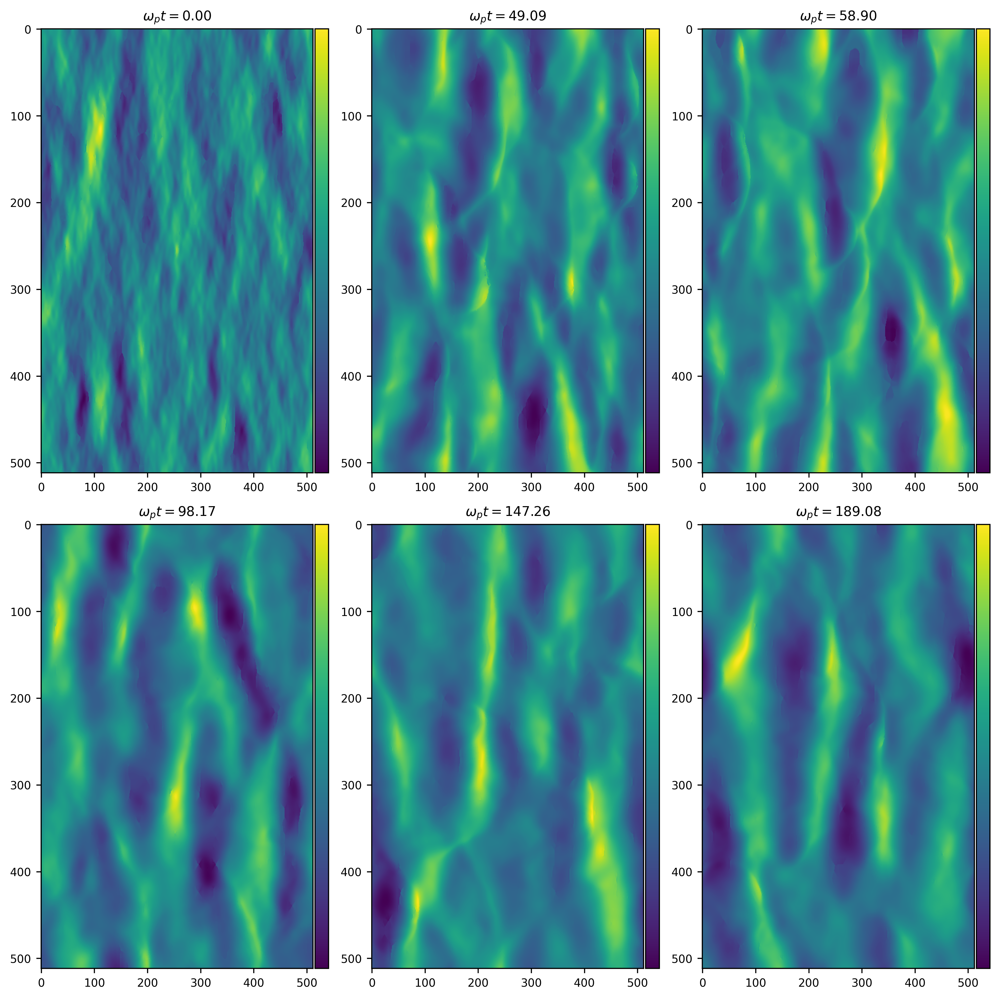

In [ ]:
ind_time = [
    0,
    100,
    250,
    300,
    500,
    700,
]  # index of the times we are interested in (depends on length of time)
kp = 4
omegap = (1 * kp) ** 0.5

tstart = time[0]


num_rows = 1
num_cols = 3

fig, axes = plt.subplots(num_rows, num_cols, figsize=(10, 10))

j = 0

for i in ind_time:
    eta = eta_series[i]
    # plt.imshow(eta)

    ax = axes[j // num_cols, j % num_cols]
    # tstart=case7.tstart

    # eta graph
    im = ax.imshow(eta, aspect="auto")

    ax.set_title(
        label=r"$\omega_{p} t=%.2f$" % (omegap * (time[i] - tstart))
    )  # Agregar un título al subplot

    # fig.colorbar(im , ax=ax, orientation='vertical', pad=0.02)

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.02)
    cbar = fig.colorbar(
        im,
        cax=cax,
        orientation="vertical",
        extendrect="False",
        fraction=0.05,
        pad=0.02,
        aspect=10,
    )

    cbar.ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"${int(x)}$"))
    cbar.ax.yaxis.set_major_locator(plt.FixedLocator([-100, -15, -10, -5, 0]))

    j += 1


plt.tight_layout()
# plt.savefig("g1_tend", dpi=300)
plt.show()

In [ ]:
# initialization of lists for checking

variance = []
integral = []
polar_integral = []

kp = 4
omegap = (1 * kp) ** 0.5

var 0.0006959344
sum F 0.0006959344015513846
integral 0.0006959344015514243
sum polar integrated 0.0007143293503143993
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.0005316243
sum F 0.0005316242798285799
integral 0.0005316242798286099
sum polar integrated 0.0005420202328107441
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.0005471837
sum F 0.00054718374663216
integral 0.000547183746632191
sum polar integrated 0.0005555806331119875
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.00059578853
sum F 0.0005957884910984554
integral 0.0005957884910984893
sum polar integrated 0.0006064386002477951
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.000663766
sum F 0.0006637660358976424
integral 0.0006637660358976801
sum polar integrated 0.0006810558989031915
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.0007607515
sum F 0.0007607515449625539
int

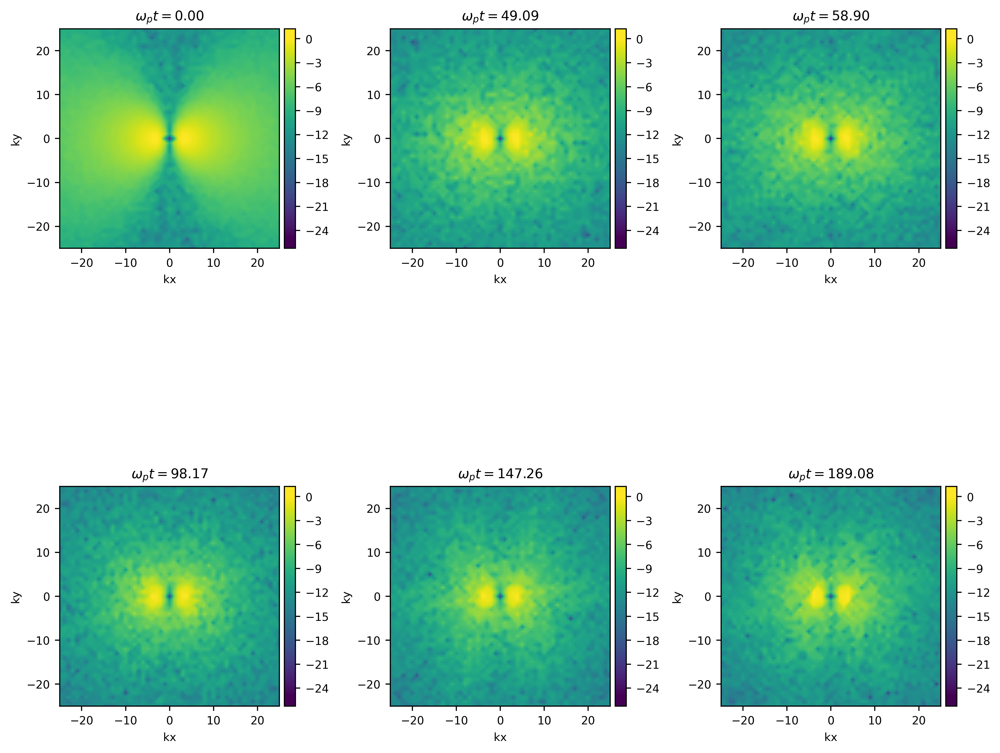

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

num_rows = 2
num_cols = 3

fig, axes = plt.subplots(num_rows, num_cols, figsize=(10, 10))

j = 0


N = 512
L = 2 * np.pi
lim = 200

for i in ind_time:
    eta = eta_series[i]

    (
        k,
        F_center,
        F_center_polar_integrated,
        F_center_polar,
        k_tile,
        kxp_tile,
        kyp_tile,
        theta_tile,
        theta,
        variance,
        integral,
        polar_integral,
        kx,
        ky,
    ) = spectrum_integration(eta - np.mean(eta), N, L, CHECK=True)

    norm = np.argmax(F_center)

    vmin = -25
    vmax = 0
    levels = np.linspace(vmin, vmax, 200)

    ax = axes[j // num_cols, j % num_cols]

    im = ax.contourf(
        kx, ky, np.log(F_center / np.max(F_center)), extend="both", levels=levels
    )

    ax.set_aspect("equal")
    ax.set_title(label=r"$\omega_{p} t=%.2f$" % (omegap * (time[i] - tstart)))
    ax.set_xlabel("kx")
    ax.set_ylabel("ky")
    ax.set_ylim([-25, 25])
    ax.set_xlim([-25, 25])

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    cbar = fig.colorbar(im, cax=cax, orientation="vertical", extendrect="False")

    cbar.ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"${int(x)}$"))
    # cbar.ax.yaxis.set_major_locator(plt.FixedLocator([-20, -15, -10, -5, 0]))

    j += 1

plt.tight_layout()
plt.show()

var 0.0006959344
sum F 0.0006959344015513846
integral 0.0006959344015514243
sum polar integrated 0.0007143293503143993
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.0005316243
sum F 0.0005316242798285799
integral 0.0005316242798286099
sum polar integrated 0.0005420202328107441
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.0005471837
sum F 0.00054718374663216
integral 0.000547183746632191
sum polar integrated 0.0005555806331119875
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.00059578853
sum F 0.0005957884910984554
integral 0.0005957884910984893
sum polar integrated 0.0006064386002477951
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.000663766
sum F 0.0006637660358976424
integral 0.0006637660358976801
sum polar integrated 0.0006810558989031915
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.0007607515
sum F 0.0007607515449625539
int

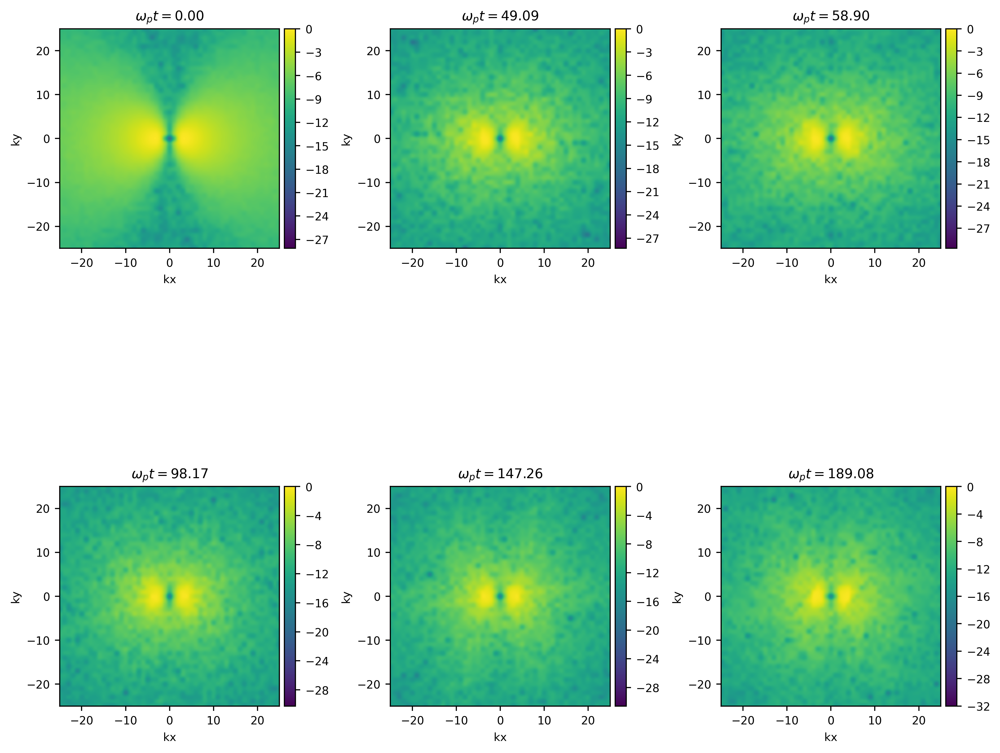

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

num_rows = 2
num_cols = 3

fig, axes = plt.subplots(num_rows, num_cols, figsize=(10, 10))

j = 0

N = 512
L = 2 * np.pi
lim = 200

for i in ind_time:
    eta = eta_series[i]

    (
        k,
        F_center,
        F_center_polar_integrated,
        F_center_polar,
        k_tile,
        kxp_tile,
        kyp_tile,
        theta_tile,
        theta,
        variance,
        integral,
        polar_integral,
        kx,
        ky,
    ) = spectrum_integration(eta - np.mean(eta), N, L, CHECK=True)

    logF = np.log(F_center / np.max(F_center))

    ax = axes[j // num_cols, j % num_cols]

    im = ax.imshow(
        logF,
        origin="lower",
        aspect="equal",
        interpolation="gaussian",
        extent=[kx.min(), kx.max(), ky.min(), ky.max()],
    )  # adjust the color range with vmin and vmax if needed

    ax.set_title(label=r"$\omega_{p} t=%.2f$" % (omegap * (time[i] - tstart)))
    ax.set_xlabel("kx")
    ax.set_ylabel("ky")
    ax.set_ylim([-25, 25])
    ax.set_xlim([-25, 25])

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    cbar = fig.colorbar(im, cax=cax, orientation="vertical")

    cbar.ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"${int(x)}$"))

    j += 1

plt.tight_layout()
plt.show()

var 0.0006959344
sum F 0.0006959344015513846
integral 0.0006959344015514243
sum polar integrated 0.0007143293503143993
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.0005316243
sum F 0.0005316242798285799
integral 0.0005316242798286099
sum polar integrated 0.0005420202328107441
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.0005471837
sum F 0.00054718374663216
integral 0.000547183746632191
sum polar integrated 0.0005555806331119875
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.00059578853
sum F 0.0005957884910984554
integral 0.0005957884910984893
sum polar integrated 0.0006064386002477951
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.000663766
sum F 0.0006637660358976424
integral 0.0006637660358976801
sum polar integrated 0.0006810558989031915
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.0007607515
sum F 0.0007607515449625539
int

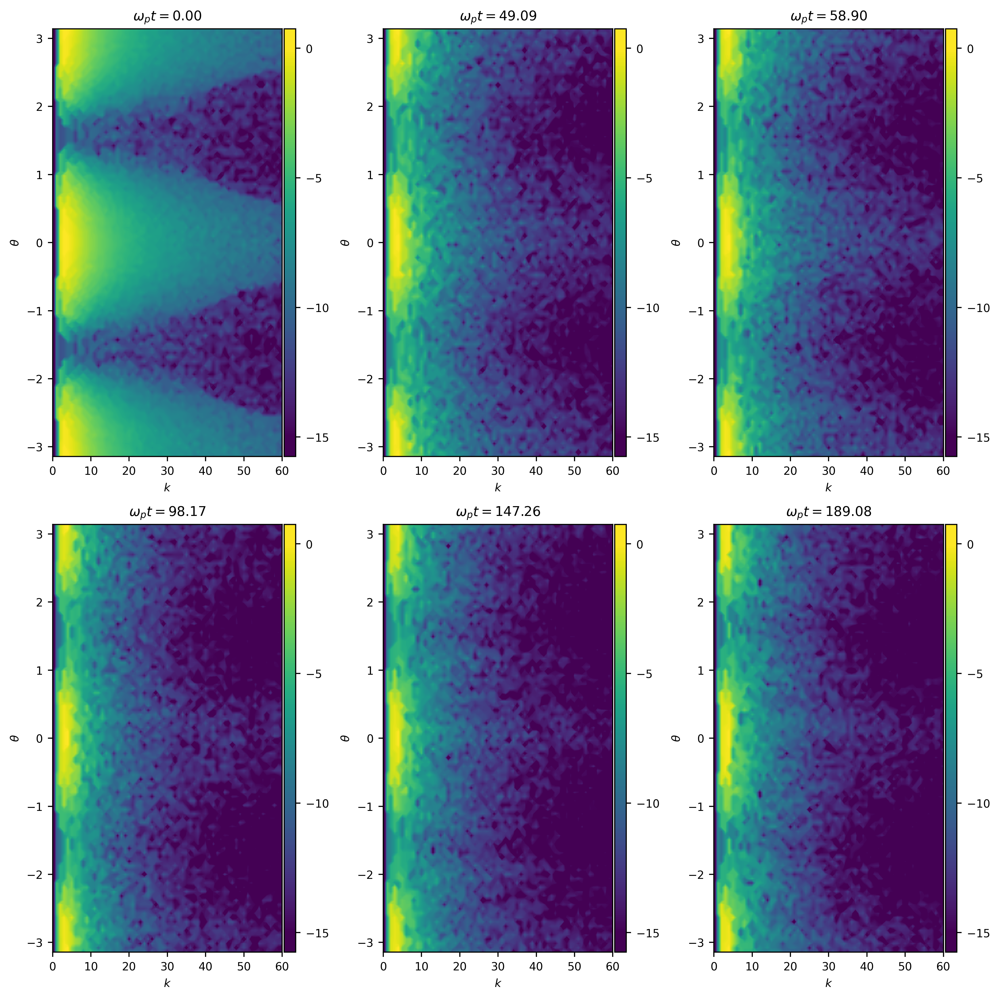

In [ ]:
num_rows = 2
num_cols = 3


N = 512
L = 2 * m.pi

fig, axes = plt.subplots(num_rows, num_cols, figsize=(10, 10))

j = 0

variance = []
integral = []
polar_integral = []

for i in ind_time:
    eta = eta_series[i]

    (
        k,
        F_center,
        F_center_polar_integrated,
        F_center_polar,
        k_tile,
        kxp_tile,
        kyp_tile,
        theta_tile,
        theta,
        variance,
        integral,
        polar_integral,
        kx,
        ky,
    ) = spectrum_integration(eta - np.mean(eta), N, L, CHECK=True)

    vmin = -15
    vmax = 0
    levels = np.linspace(vmin, vmax, 200)

    plt.contourf(
        k_tile,
        theta_tile,
        np.log(F_center_polar / np.max(F_center_polar)),
        levels=levels,
        extend="both",
    )  # , cmap='viridis')

    ax = axes[j // num_cols, j % num_cols]

    im = ax.contourf(
        k_tile,
        theta_tile,
        np.log(F_center_polar / np.max(F_center_polar)),
        levels=levels,
        extend="both",
    )  # , cmap='viridis')

    # ax.scatter(4,0,marker ='*', s=1, alpha= 1, c='r' )

    ax.set_title(label=r"$\omega_{p} t=%.2f$" % (omegap * (time[i] - tstart)))

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.02)
    cbar = fig.colorbar(
        im,
        cax=cax,
        orientation="vertical",
        extendrect="False",
        fraction=0.05,
        pad=0.02,
        aspect=10,
    )

    cbar.ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"${int(x)}$"))
    cbar.ax.yaxis.set_major_locator(plt.FixedLocator([-20, -15, -10, -5, 0]))

    ax.set_xlim([0, 60])
    ax.set_xlabel("$k$")
    ax.set_ylabel(r"$ \theta $")
    j += 1


plt.tight_layout()
# plt.savefig("g1_tend", dpi=300)
plt.show()

var 0.0006959344
sum F 0.0006959344015513846
integral 0.0006959344015514243
sum polar integrated 0.0007143293503143993
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.0005316243
sum F 0.0005316242798285799
integral 0.0005316242798286099
sum polar integrated 0.0005420202328107441
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.0005471837
sum F 0.00054718374663216
integral 0.000547183746632191
sum polar integrated 0.0005555806331119875
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.00059578853
sum F 0.0005957884910984554
integral 0.0005957884910984893
sum polar integrated 0.0006064386002477951
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.000663766
sum F 0.0006637660358976424
integral 0.0006637660358976801
sum polar integrated 0.0006810558989031915
F center (512, 512) F polar (100, 256) F center polar integrated (256,)
var 0.0007607515
sum F 0.0007607515449625539
int

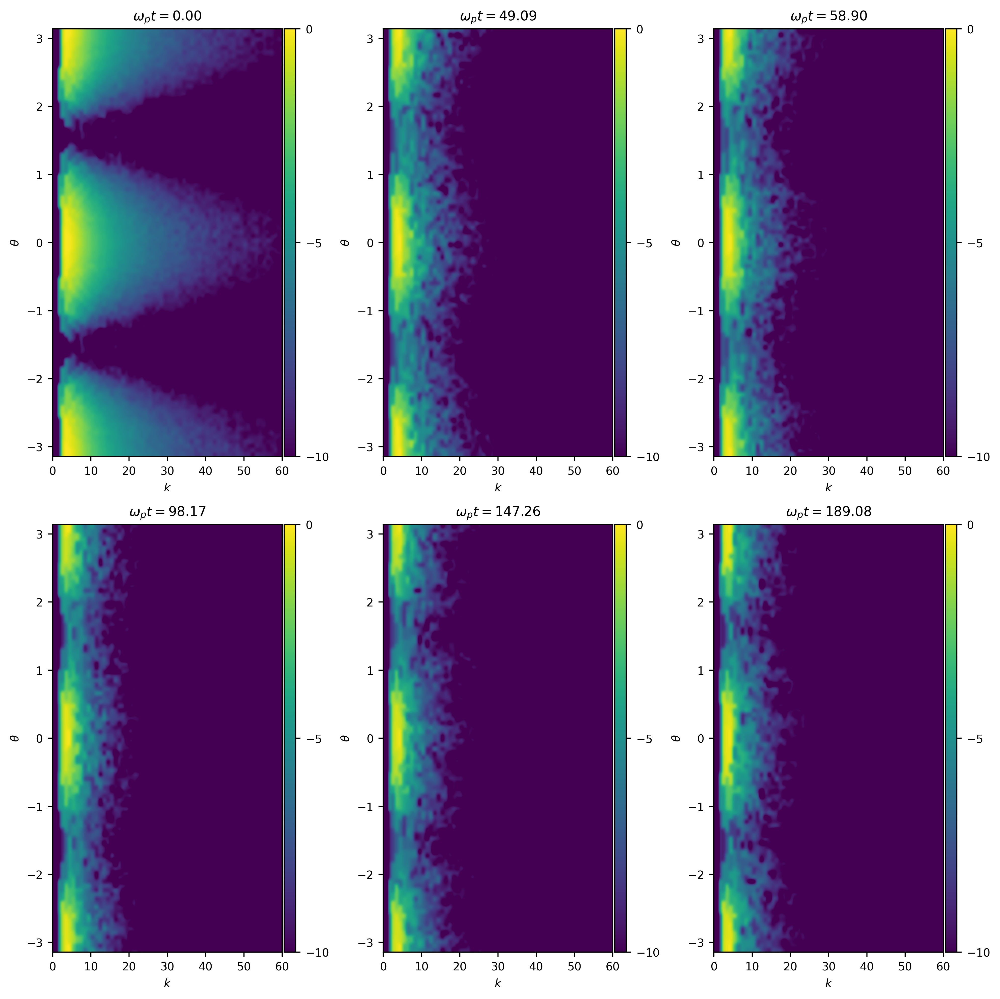

In [ ]:
num_rows = 1
num_cols = 3

N = 512
L = 2 * m.pi

fig, axes = plt.subplots(num_rows, num_cols, figsize=(10, 10))

j = 0

variance = []
integral = []
polar_integral = []

for i in ind_time:
    eta = eta_series[i]

    (
        k,
        F_center,
        F_center_polar_integrated,
        F_center_polar,
        k_tile,
        kxp_tile,
        kyp_tile,
        theta_tile,
        theta,
        variance,
        integral,
        polar_integral,
        kx,
        ky,
    ) = spectrum_integration(eta - np.mean(eta), N, L, CHECK=True)

    vmin = -10
    vmax = 0
    levels = np.linspace(vmin, vmax, 200)

    ax = axes[j // num_cols, j % num_cols]

    data = np.log(F_center_polar / np.max(F_center_polar))
    extent = [
        k_tile.min(),
        k_tile.max(),
        theta_tile.min(),
        theta_tile.max(),
    ]  # Defines the bounding box

    im = ax.imshow(
        data,
        extent=extent,
        aspect="auto",
        origin="lower",
        interpolation="gaussian",
        cmap="viridis",
        vmin=vmin,
        vmax=vmax,
    )

    ax.set_title(label=r"$\omega_{p} t=%.2f$" % (omegap * (time[i] - tstart)))

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.02)
    cbar = fig.colorbar(
        im,
        cax=cax,
        orientation="vertical",
        extendrect="False",
        fraction=0.05,
        pad=0.02,
        aspect=10,
    )

    cbar.ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"${int(x)}$"))
    cbar.ax.yaxis.set_major_locator(plt.FixedLocator([-20, -15, -10, -5, 0]))

    ax.set_xlim([0, 60])
    ax.set_xlabel("$k$")
    ax.set_ylabel(r"$ \theta $")
    j += 1

plt.tight_layout()
# plt.savefig("g1_tend", dpi=300)
plt.show()

[3 4 5 6 7]
[3, 4, 5, 6]


No handles with labels found to put in legend.


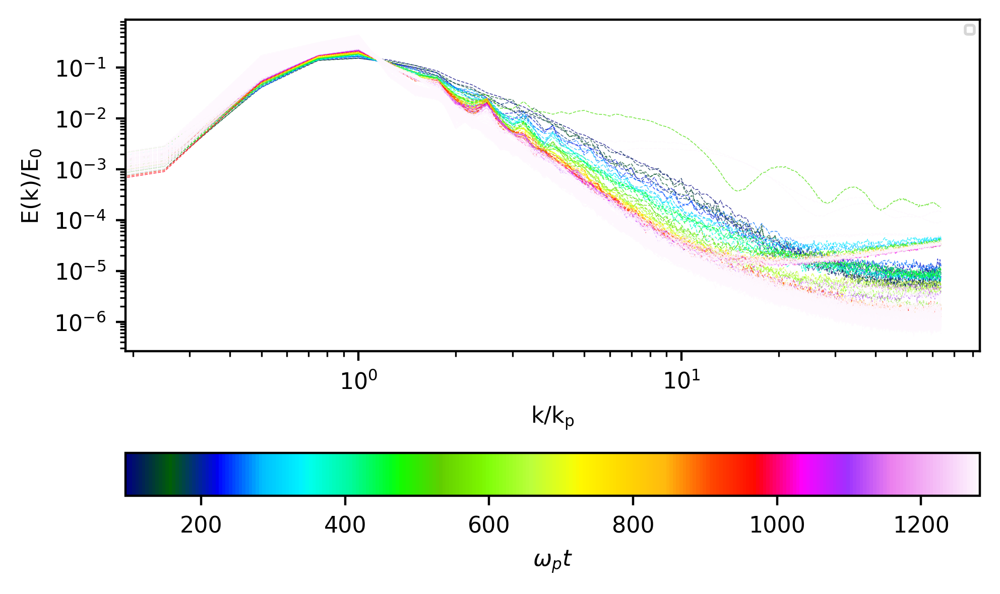

In [ ]:
import matplotlib.cm as cm

fig = plt.figure(figsize=[5, 3])
ax = fig.gca()

num_rows = 2
num_cols = 3

kp = 4

N = 512
L = 2 * np.pi

j = 0

variance = []
integral = []
polar_integral = []

# modes growth
energy_mode = []
coordx_mode = []
k_second = []

energy_secondmode = []
coordx_secondmode = []


filtered_coordx_mode = []
filtered_energy_mode = []

for i in range(len(eta_series)):
    eta = eta_series[i]

    (
        k,
        F_center,
        F_center_polar_integrated,
        F_center_polar,
        k_tile,
        kxp_tile,
        kyp_tile,
        theta_tile,
        theta,
        variance,
        integral,
        polar_integral,
        kx,
        ky,
    ) = spectrum_integration(eta - np.mean(eta), N, L, CHECK=False)

    if i == 0:
        filtered_indices = np.where((k > 1) & (k <= 110))[
            0
        ]  # Obtener los índices correspondientes en el rango de k deseado
        indices = np.argsort(-F_center_polar_integrated[filtered_indices])[
            :5
        ]  # Tomar solo los 4 máximos dentro del rango filtrado
        indices = filtered_indices[
            indices
        ]  # Obtener los índices correspondientes en el array completo
        indices = np.sort(indices)
        print(indices)

        k_second = [(indices[i] + indices[i + 1]) // 2 for i in range(len(indices) - 1)]

        print(k_second)

    energy = F_center_polar_integrated[indices]

    coordx = k[indices] / kp

    coordx_second = k[k_second] / kp

    energy_second = F_center_polar_integrated[k_second]

    # print(energy, coordx)

    dk = k[1] - k[0]

    if i == 0:
        E0 = np.sum(F_center_polar_integrated) * dk
        E0_nodes = F_center_polar_integrated[indices]
        E0_second = F_center_polar_integrated[k_second]

    if i % 5 == 0:
        psd = ax.plot(
            k / kp,
            F_center_polar_integrated / E0,
            "--",
            color=plt.cm.get_cmap("gist_ncar")(j),
            alpha=0.7,
            linewidth=0.3,
        )

    energy_mode.append(energy.tolist())
    energy_secondmode.append(energy_second.tolist())
    coordx_secondmode.append(coordx_second.tolist())

    coordx_mode.append(coordx.tolist())

    j += 1
"""
# plot where are the nodes
for a in range(len(energy_mode[0])):
    plt.axvline(x=coordx_mode[0][a], ls='--', color=plt.cm.get_cmap('viridis')((a + 2) / 7), lw=0.5, alpha = 0.8 , 
                label=r'$k =%.0f$' % coordx_mode[0][a])
    
    
for a in range(len(energy_secondmode[0])):
    plt.axvline(x=coordx_secondmode[0][a], ls='--', color=plt.cm.get_cmap('magma')((a + 2) / 7), lw=0.3, alpha = 0.5, 
                label=r'$ k =%.0f$' % coordx_secondmode[0][a])
"""

ax.ticklabel_format(style="sci", axis="y", scilimits=(0, 0))
plt.legend(loc="upper right", fontsize=4)
color_map = cm.get_cmap("gist_ncar")
norm = plt.Normalize(vmin=time[0], vmax=(time[-1] - time[0]))
sm = plt.cm.ScalarMappable(cmap=color_map, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, orientation="horizontal", pad=0.2)
fig.tight_layout()
cbar.set_label("$\omega_{p} t$")
plt.xscale("log")
plt.yscale("log")
plt.xlabel("$\mathdefault{k/k_{p}}$")
plt.ylabel("$\mathdefault{E(k)/E_{0}}$")
fig.tight_layout()

We are intereseted in the time where the energy increases

findfont: Font family ['Open Sans'] not found. Falling back to DejaVu Sans.


964 964


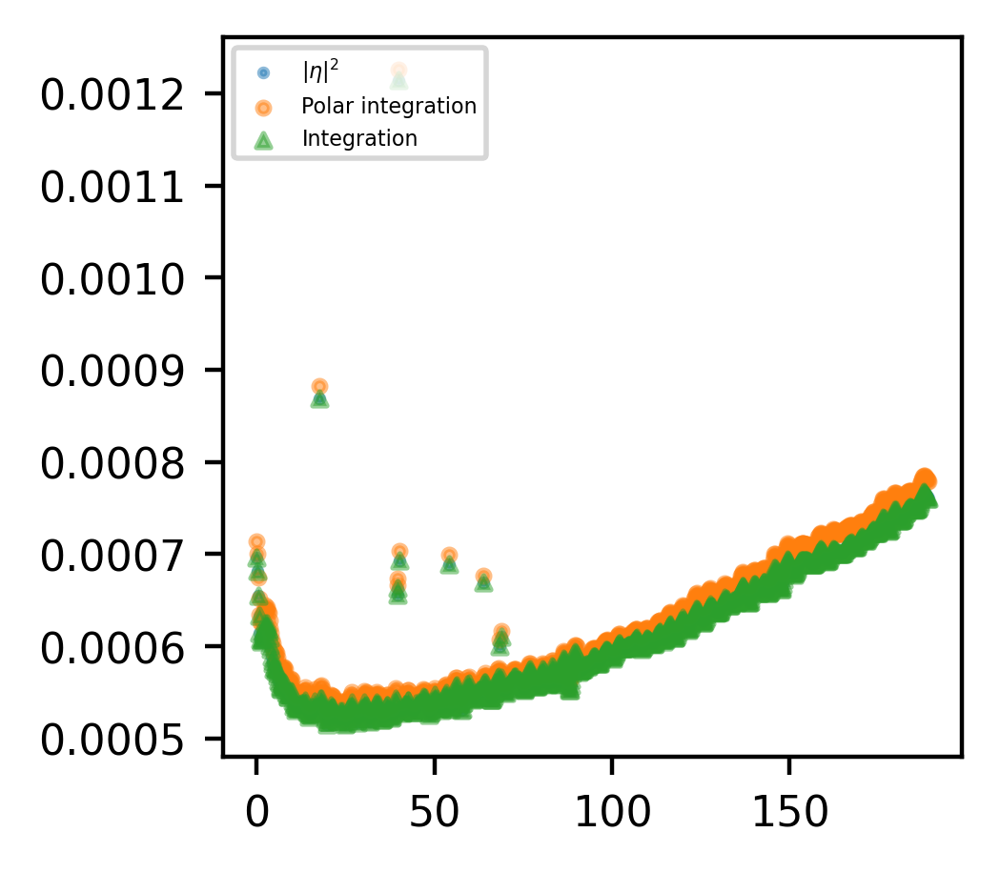

In [ ]:
fig = plt.figure(figsize=[2.5, 2.5])
ax = fig.gca()
tiempo = []

for i in range(len(eta_series)):
    tiempo.append(omegap * (time[i] - tstart))

print(len(tiempo), len(variance))
plt.scatter(tiempo, variance, s=2, label="$|\eta|^2$", alpha=0.5)
plt.scatter(tiempo, polar_integral, s=5, label="Polar integration", alpha=0.5)
plt.scatter(tiempo, integral, marker="^", s=7, label="Integration", alpha=0.5)
plt.legend(loc="upper left", fontsize=4)
plt.show()

964 964


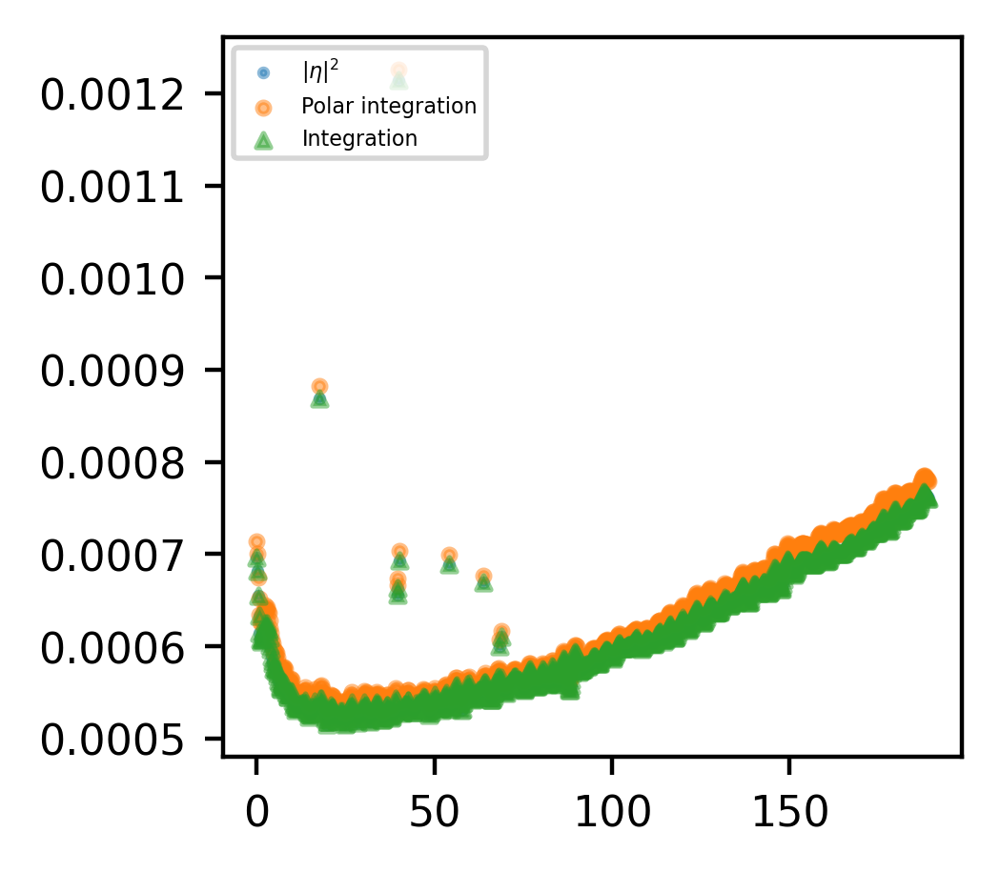

In [ ]:
# select times after omegap*(time[i]-tstart))  = 50

fig = plt.figure(figsize=[2.5, 2.5])
ax = fig.gca()
tiempo = []

for i in range(len(eta_series)):
    tiempo.append(omegap * (time[i] - tstart))

print(len(tiempo), len(variance))
plt.scatter(tiempo, variance, s=2, label="$|\eta|^2$", alpha=0.5)
plt.scatter(tiempo, polar_integral, s=5, label="Polar integration", alpha=0.5)
plt.scatter(tiempo, integral, marker="^", s=7, label="Integration", alpha=0.5)
plt.legend(loc="upper left", fontsize=4)
plt.show()

In [ ]:
mode = []

for i in range(len(energy_mode[0])):
    energy = []
    for j in range(len(energy_mode)):
        energy.append(np.array(energy_mode[j][i]))
    mode.append(energy)


mode_second = []

for i in range(len(energy_secondmode[0])):
    energy_second = []
    for j in range(len(energy_secondmode)):
        energy_second.append(np.array(energy_secondmode[j][i]))
    mode_second.append(energy_second)

k 3 slope 0.0017921828439266705 SSR 0.06075020041554817 R^2 0.9743867162171926
k 4 slope 0.0028331829288068453 SSR 0.23504376235602759 R^2 0.9608955222494096
k 5 slope -0.00047945243623400725 SSR 0.07742668561909705 R^2 0.6811466133933359
k 6 slope -0.0005664802625258814 SSR 0.06974803264878644 R^2 0.7680055570181494
k 7 slope -0.00042203862419938653 SSR 0.028069073159746202 R^2 0.8203342337834584
k 3 slope 0.0017921828439266705 SSR 0.06075020041554817 R^2 0.9743867162171926
k 4 slope 0.0028331829288068453 SSR 0.23504376235602759 R^2 0.9608955222494096
k 5 slope -0.00047945243623400725 SSR 0.07742668561909705 R^2 0.6811466133933359
k 6 slope -0.0005664802625258814 SSR 0.06974803264878644 R^2 0.7680055570181494
[0.0017921828439266705, 0.0028331829288068453, -0.00047945243623400725, -0.0005664802625258814, -0.00042203862419938653]


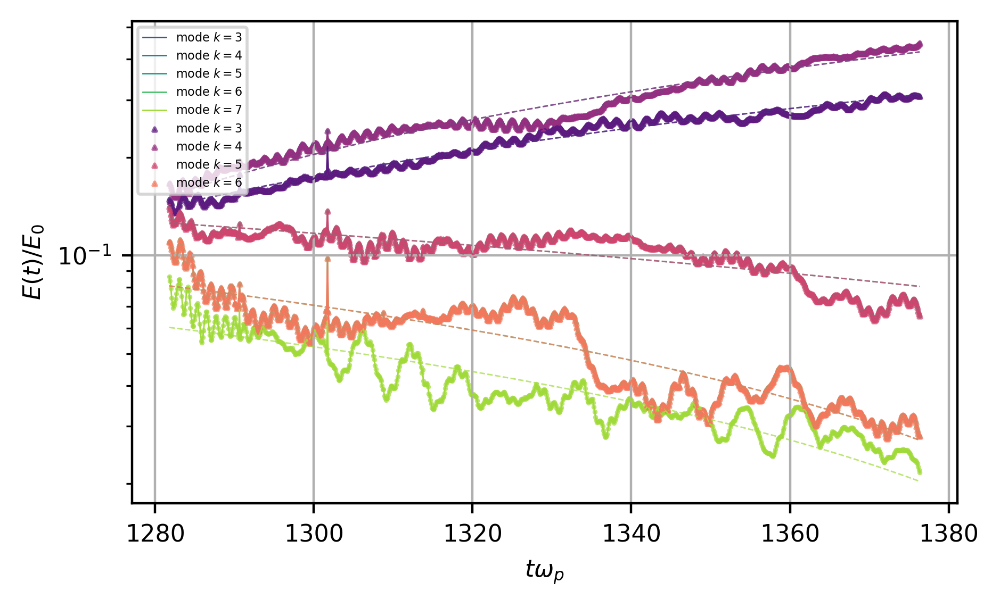

In [ ]:
# EXPONENTIAL FIT


import numpy as np
import matplotlib.pyplot as plt

fig = plt.figure(figsize=[5, 3])
ax_main = plt.gca()
slopes = []
ssr_values = []
r2_values = []


for i in range(len(mode)):
    # Normalize the mode values
    mode_total_norm = [x / E0 for x in mode[i]]

    # Plot the normalized mode
    plt.plot(
        time,
        mode_total_norm,
        "-",
        color=plt.cm.get_cmap("viridis")((i + 2) / 7),
        lw=0.5,
        label=r"mode $k=%.0f$" % (indices[i]),
    )
    plt.scatter(
        time,
        mode_total_norm,
        color=plt.cm.get_cmap("viridis")((i + 2) / 7),
        s=0.5,
        alpha=0.7,
    )

    # Fit a straight line to the data
    coefficients = np.polyfit(time, mode_total_norm, 1)
    line = np.poly1d(coefficients)
    slope = coefficients[0]

    # Calculate the y-values corresponding to the regression line
    y_line = line(time)

    # Calculate SSR (Sum of Squared Residuals)
    residuals = mode_total_norm - y_line
    ssr = np.sum(residuals**2)
    ssr_values.append(ssr)

    # Calculate R^2 (coefficient of determination)
    ss_total = np.sum((mode_total_norm - np.mean(mode_total_norm)) ** 2)
    r2 = 1 - (ssr / ss_total)
    r2_values.append(r2)

    # Plot the regression line on the main axis
    plt.plot(
        time,
        y_line,
        "--",
        color=plt.cm.get_cmap("viridis")((i + 2) / 7),
        lw=0.5,
        alpha=0.7,
    )

    print("k", indices[i], "slope", slope, "SSR", ssr, "R^2", r2)

    slopes.append(slope)

slopes_second = []

slopes_second = []


for i in range(len(mode_second)):
    # Normalize the mode values
    mode_total_norm = [x / E0 for x in mode_second[i]]

    # Plot the normalized mode
    plt.plot(
        time, mode_total_norm, "-", color=plt.cm.get_cmap("magma")((i + 2) / 7), lw=0.5
    )
    plt.scatter(
        time,
        mode_total_norm,
        marker="^",
        color=plt.cm.get_cmap("magma")((i + 2) / 7),
        s=1.5,
        alpha=0.7,
        label=r"mode $k=%.0f$" % (k_second[i]),
    )

    # Fit a straight line to the data
    coefficients = np.polyfit(time, (mode_total_norm), 1)
    line = np.poly1d(coefficients)
    slope = coefficients[0]

    # Calculate the y-values corresponding to the regression line
    y_line = line(
        time
    )  # (in order to appear like ligne in the plot, what do you think?

    # Calculate SSR (Sum of Squared Residuals)
    residuals = mode_total_norm - y_line
    ssr = np.sum(residuals**2)
    ssr_values.append(ssr)

    # Calculate R^2 (coefficient of determination)
    ss_total = np.sum((mode_total_norm - np.mean(mode_total_norm)) ** 2)
    r2 = 1 - (ssr / ss_total)
    r2_values.append(r2)

    # Plot the regression line on the main axis
    plt.plot(
        time,
        y_line,
        "--",
        color=plt.cm.get_cmap("magma")((i + 2) / 7),
        lw=0.5,
        alpha=0.7,
    )

    print("k", k_second[i], "slope", slope, "SSR", ssr, "R^2", r2)

    slopes_second.append(slope)

print(slopes)
ax_main.ticklabel_format(style="sci", axis="y", scilimits=(0, 0))
plt.legend(loc="upper left", fontsize=4)
ax_main.set_xlabel("$t \omega_{p}$")
plt.yscale("log")
# ax_main.set_yscale('log')
ax_main.set_ylabel("$E(t)/E_{0}$")
# ax_main.set_title("Normalization by the total initial energy")
plt.grid(True)

k 3 slope 0.00826098404841082 SSR 0.12311043132027757 R^2 0.9480946170965545
k 4 slope 0.010023662596801007 SSR 0.11668080770339782 R^2 0.9805876914025605
k 5 slope -0.005039301028418329 SSR 0.08808179094686792 R^2 0.6372674728716281
k 6 slope -0.010959151865485597 SSR 0.07291561531728256 R^2 0.7574696099975776
k 7 slope -0.010155918758039137 SSR 0.020832362963437878 R^2 0.8666552888075121
[0.00826098404841082, 0.010023662596801007, -0.005039301028418329, -0.010959151865485597, -0.010155918758039137]


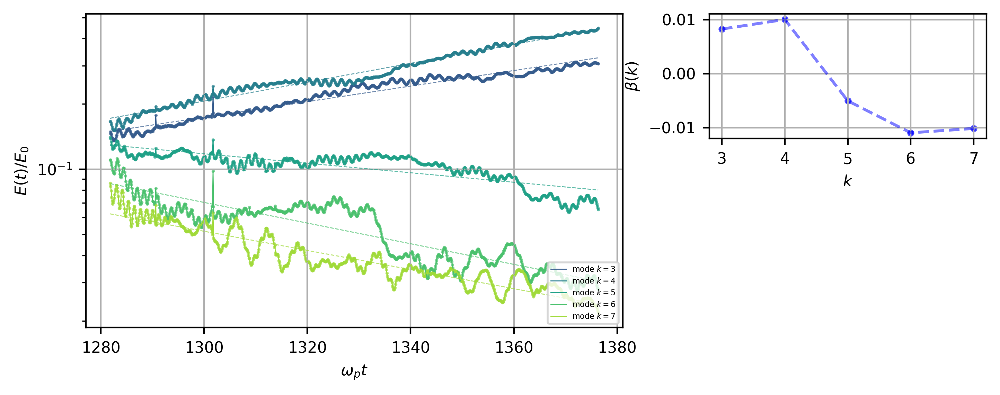

In [ ]:
# EXPONENTIAL FIT


import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

fig = plt.figure(figsize=[5, 3])
ax_main = plt.gca()
slopes = []
ssr_values = []
r2_values = []

slopes_exp = []

for i in range(len(mode)):
    # Normalize the mode values
    mode_total_norm = [x / E0 for x in mode[i]]

    # Plot the normalized mode
    plt.plot(
        time,
        mode_total_norm,
        "-",
        color=plt.cm.get_cmap("viridis")((i + 2) / 7),
        lw=0.5,
        label=r"mode $k=%.0f$" % (indices[i]),
    )
    plt.scatter(
        time,
        mode_total_norm,
        color=plt.cm.get_cmap("viridis")((i + 2) / 7),
        s=0.5,
        alpha=0.7,
    )

    p = np.polyfit(time, np.log(mode_total_norm), 1)

    # Convert the polynomial back into an exponential
    a = np.exp(p[1])
    b = p[0]

    slope = b

    # x_fitted = np.linspace(np.min(x), np.max(x), 100)
    y_exponential = a * np.exp(b * time)
    # Calculate SSR (Sum of Squared Residuals)
    residuals = mode_total_norm - y_exponential
    ssr = np.sum(residuals**2)
    ssr_values.append(ssr)

    # Calculate R^2 (coefficient of determination)
    ss_total = np.sum((mode_total_norm - np.mean(mode_total_norm)) ** 2)
    r2 = 1 - (ssr / ss_total)
    r2_values.append(r2)

    # Plot the exponential curve on the main axis
    plt.plot(
        time,
        y_exponential,
        "--",
        color=plt.cm.get_cmap("viridis")((i + 2) / 7),
        lw=0.5,
        alpha=0.7,
    )

    print("k", indices[i], "slope", slope, "SSR", ssr, "R^2", r2)

    slopes_exp.append(slope)

# Rest of the code remains unchanged

# These are in unitless percentages of the figure size. (0,0 is bottom left)
left, bottom, width, height = [1.025, 0.58, 0.4, 0.3]
ax2 = fig.add_axes([left, bottom, width, height])

# ax2.figure(figsize=[3,1.5]); ax = plt.gca()
ax2.plot(indices, slopes_exp, "--", c="b", alpha=0.5)
ax2.scatter(indices, slopes_exp, s=7, alpha=0.65, c="b")
ax2.set_xlabel("$k$")
ax2.set_ylabel(r"$ \beta (k)$")
# ax2.set_ylim([0,0.14])
ax2.grid(True)


print(slopes_exp)
# ax_main.set_ylim([10**(-3),10])
ax_main.ticklabel_format(style="sci", axis="y", scilimits=(0, 0))
ax_main.legend(loc="lower right", fontsize=4)
ax_main.set_xlabel("$\omega_{p} t$")
ax_main.set_yscale("log")
ax_main.set_ylabel("$E(t)/E_{0}$")
# ax_main.set_title("Normalization by the total initial energy")
ax_main.grid(True)

k 3 slope 0.00826098404841082 SSR 0.12311043132027757 R^2 0.9480946170965545
k 4 slope 0.010023662596801007 SSR 0.11668080770339782 R^2 0.9805876914025605
k 5 slope -0.005039301028418329 SSR 0.08808179094686792 R^2 0.6372674728716281
k 6 slope -0.010959151865485597 SSR 0.07291561531728256 R^2 0.7574696099975776
[0.00826098404841082, 0.010023662596801007, -0.005039301028418329, -0.010959151865485597]


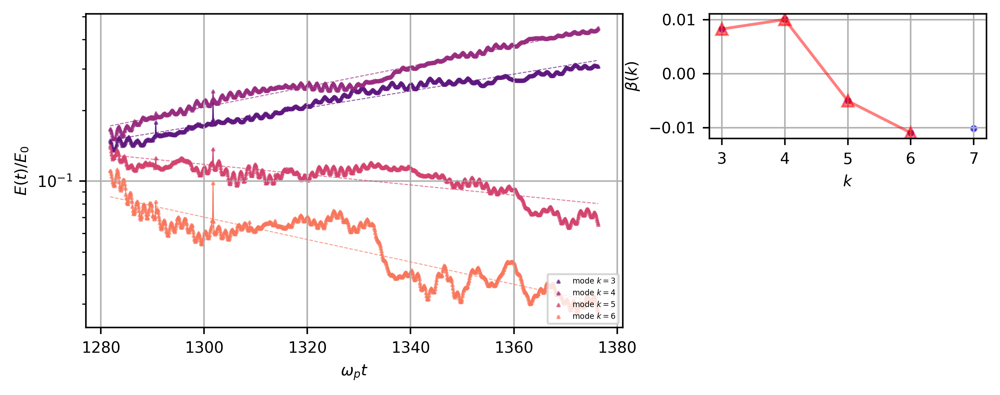

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# EXPONENTIAL FIT


fig = plt.figure(figsize=[5, 3])
ax_main = plt.gca()
ssr_values = []
r2_values = []


slopes_second_exp = []


for i in range(len(mode_second)):
    # Normalize the mode values
    mode_total_norm = [x / E0 for x in mode_second[i]]

    # Plot the normalized mode
    plt.plot(
        time, mode_total_norm, "-", color=plt.cm.get_cmap("magma")((i + 2) / 7), lw=0.5
    )
    plt.scatter(
        time,
        mode_total_norm,
        marker="^",
        color=plt.cm.get_cmap("magma")((i + 2) / 7),
        s=1.5,
        alpha=0.7,
        label=r"mode $k=%.0f$" % (k_second[i]),
    )

    # Fit an exponential curve to the data
    p = np.polyfit(time, np.log(mode_total_norm), 1)

    # Convert the polynomial back into an exponential
    a = np.exp(p[1])
    b = p[0]

    slope = b

    # x_fitted = np.linspace(np.min(x), np.max(x), 100)
    y_exponential = a * np.exp(b * time)

    # Calculate SSR (Sum of Squared Residuals)
    residuals = mode_total_norm - y_exponential
    ssr = np.sum(residuals**2)
    ssr_values.append(ssr)

    # Calculate R^2 (coefficient of determination)
    ss_total = np.sum((mode_total_norm - np.mean(mode_total_norm)) ** 2)
    r2 = 1 - (ssr / ss_total)
    r2_values.append(r2)

    # Plot the exponential curve on the main axis
    plt.plot(
        time,
        y_exponential,
        "--",
        color=plt.cm.get_cmap("magma")((i + 2) / 7),
        lw=0.5,
        alpha=0.7,
    )

    print("k", k_second[i], "slope", slope, "SSR", ssr, "R^2", r2)

    slopes_second_exp.append(slope)


# Rest of the code remains unchanged
# These are in unitless percentages of the figure size. (0,0 is bottom left)
left, bottom, width, height = [1.025, 0.58, 0.4, 0.3]
ax2 = fig.add_axes([left, bottom, width, height])

# ax2.figure(figsize=[3,1.5]); ax = plt.gca()
ax2.plot(k_second, slopes_second_exp, "^-", c="red", alpha=0.5)
ax2.scatter(indices, slopes_exp, s=7, alpha=0.65, c="b")
ax2.set_xlabel("$k$")
ax2.set_ylabel(r"$ \beta (k) $")
# ax2.set_ylim([0,0.14])
ax2.grid(True)


print(slopes_second_exp)
# ax_main.set_ylim([10**(-4),10**(-3)])
ax_main.ticklabel_format(style="sci", axis="y", scilimits=(0, 0))
ax_main.legend(loc="lower right", fontsize=4)
ax_main.set_xlabel("$\omega_{p} t$")
ax_main.set_yscale("log")
ax_main.set_ylabel("$E(t)/E_{0}$")
# ax_main.set_title("Normalization by the total initial energy")
ax_main.grid(True)

k 3 slope 0.00826098404841082 SSR 0.12311043132027757 R^2 0.9480946170965545
k 4 slope 0.010023662596801007 SSR 0.11668080770339782 R^2 0.9805876914025605
k 5 slope -0.005039301028418329 SSR 0.08808179094686792 R^2 0.6372674728716281
k 6 slope -0.010959151865485597 SSR 0.07291561531728256 R^2 0.7574696099975776
[0.0017921828439266705, 0.0028331829288068453, -0.00047945243623400725, -0.0005664802625258814]


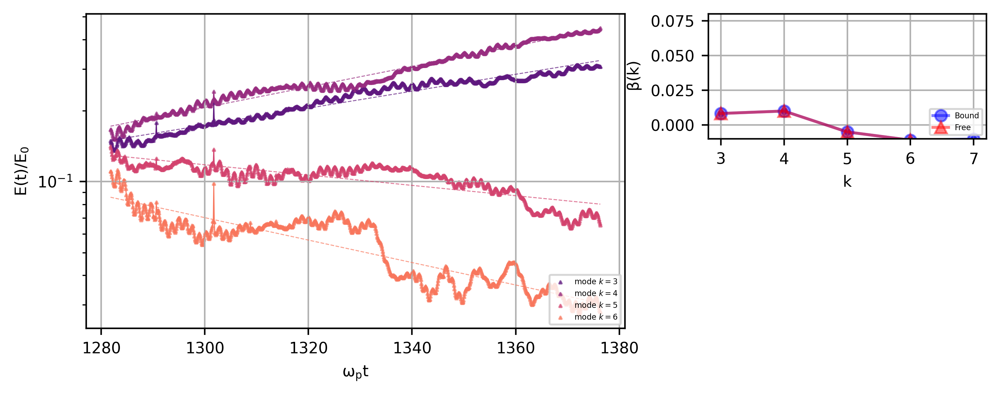

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# EXPONENTIAL FIT


fig = plt.figure(figsize=[5, 3])
ax_main = plt.gca()
ssr_values = []
r2_values = []


slopes_second_exp = []


for i in range(len(mode_second)):
    # Normalize the mode values
    mode_total_norm = [x / E0 for x in mode_second[i]]

    # Plot the normalized mode
    plt.plot(
        time, mode_total_norm, "-", color=plt.cm.get_cmap("magma")((i + 2) / 7), lw=0.5
    )
    plt.scatter(
        time,
        mode_total_norm,
        marker="^",
        color=plt.cm.get_cmap("magma")((i + 2) / 7),
        s=1.5,
        alpha=0.7,
        label=r"mode $k=%.0f$" % (k_second[i]),
    )

    p = np.polyfit(time, np.log(mode_total_norm), 1)

    # Convert the polynomial back into an exponential
    a = np.exp(p[1])
    b = p[0]

    slope = b

    # x_fitted = np.linspace(np.min(x), np.max(x), 100)
    y_exponential = a * np.exp(b * time)

    # Calculate SSR (Sum of Squared Residuals)
    residuals = mode_total_norm - y_exponential
    ssr = np.sum(residuals**2)
    ssr_values.append(ssr)

    # Calculate R^2 (coefficient of determination)
    ss_total = np.sum((mode_total_norm - np.mean(mode_total_norm)) ** 2)
    r2 = 1 - (ssr / ss_total)
    r2_values.append(r2)

    # Plot the exponential curve on the main axis
    plt.plot(
        time,
        y_exponential,
        "--",
        color=plt.cm.get_cmap("magma")((i + 2) / 7),
        lw=0.5,
        alpha=0.7,
    )

    print("k", k_second[i], "slope", slope, "SSR", ssr, "R^2", r2)

    slopes_second_exp.append(slope)


# Rest of the code remains unchanged
# These are in unitless percentages of the figure size. (0,0 is bottom left)
left, bottom, width, height = [1.02, 0.58, 0.4, 0.3]
ax2 = fig.add_axes([left, bottom, width, height])

# ax2.figure(figsize=[3,1.5]); ax = plt.gca()
# ax2.figure(figsize=[3,1.5]); ax = plt.gca()
ax2.plot(indices, slopes_exp, "o-", c="b", alpha=0.5, label="Bound")
ax2.scatter(indices, slopes_exp, s=7, alpha=0.65, c="b")
ax2.plot(k_second, slopes_second_exp, "^-", c="red", alpha=0.5, label="Free")
# ax2.scatter(k_second,slopes_second_exp, s=7, alpha =0.65, c='r')
ax2.set_xlabel("$\mathdefault{ k}$")
ax2.set_ylabel(r"$\mathdefault{\beta (k)}$")
ax2.legend(loc="lower right", fontsize=4)
ax2.set_ylim([-0.01, 0.08])
ax2.grid(True)


print(slopes_second)
# ax_main.set_ylim([10**(-4),10**(-3)])
ax_main.ticklabel_format(style="sci", axis="y", scilimits=(0, 0))
ax_main.legend(loc="lower right", fontsize=4)
ax_main.set_xlabel("$\mathdefault{ \omega_{p} t}$")
ax_main.set_yscale("log")
ax_main.set_ylabel("$\mathdefault{ E(t)/E_{0}}$")
# ax_main.set_title("Normalization by the total initial energy")
ax_main.grid(True)

In [ ]:
"""
N = 512
kp = 4; omegap = (1*kp)**0.5

Nt = len(time)

eta_series = np.zeros((Nt,N,N), dtype=np.float32)

for i in range(len(time)):
    #print('time',time[i])
    eta =  eta_series[i]
    eta_series[i] = eta
print(eta_series.shape)

data = eta_series
"""

"\nN = 512\nkp = 4; omegap = (1*kp)**0.5\n\nNt = len(time)\n\neta_series = np.zeros((Nt,N,N), dtype=np.float32)\n\nfor i in range(len(time)):\n    #print('time',time[i])\n    eta =  eta_series[i]\n    eta_series[i] = eta\nprint(eta_series.shape)\n\ndata = eta_series\n"

In [ ]:
print(eta_series.shape)
data = eta_series
# print(eta_series[4])

(964, 512, 512)


In [ ]:
dt = time[1] - time[0]  # sampling intervals, (s)
T = time[-1] - time[0]  # total duration
Nt = data.shape[0]


L0 = 2 * m.pi
N = 512  # Domain size and grid number in each direction

dx = L0 / N  # spatial sampling step along X in (m)
dy = L0 / N  # spatial sampling step along Y in (m)

t_max = dt * data.shape[0]  # s
x_max = dx * data.shape[1]  # m
y_max = dy * data.shape[2]  # m

rmax = (x_max**2 + y_max**2) ** 0.5
nr = Nt  # number intervals in r

radii = np.linspace(0, rmax, nr)

x = np.linspace(0, x_max, data.shape[1])  # m
y = np.linspace(0, y_max, data.shape[2])  # m
xx, yy = np.meshgrid(x, y, indexing="ij")

# omega = np.linspace(-np.pi/dt , np.pi/dt , data.shape[0])                          # frequency (Hz)
theta = np.linspace(0, 2 * np.pi, Nt)

wavenumber = 2 * np.pi * np.fft.fftfreq(N, L0 / N)
omega = 2 * np.pi * np.fft.fftshift(np.fft.fftfreq(Nt, T / Nt))
kx = np.fft.fftshift(wavenumber)
ky = kx


k = wavenumber[0 : int(N / 2)]  # only k>0
# omega = omega[int(Nt/2):] #only freq>0

dkx = kx[1] - kx[0]
dky = ky[1] - ky[0]
dk = k[1] - k[0]
dtheta = theta[1] - theta[0]
domega = omega[1] - omega[0]


kx_tile, ky_tile = np.meshgrid(kx, ky)  # kx-ky space
Omega, K = np.meshgrid(omega, k)  # k-omega space

k_tile, theta_tile = np.meshgrid(k, theta)  # k-theta space
kxp_tile, kyp_tile = pol2cart(k_tile, theta_tile)

In [ ]:
spectrum3D = np.fft.fftn(data / (N**2 * Nt))  # FFT normalization

spectrum3D = np.fft.fftshift(spectrum3D, axes=(0, 1, 2))

F_3D = (
    (np.absolute(spectrum3D)) ** 2 / (N**2) / Nt / (dkx * dky * domega**2)
)  # Per area normalization

# Fcenter_3D = np.fft.fftshift(F_3D, axes=(0,1,2))

In [ ]:
F_xyomega = np.zeros((N, F_3D.shape[0], N))
F_kthetaomega = np.zeros((theta.shape[0], F_3D.shape[0], k.shape[0]))
F_komega = np.zeros((256, F_3D.shape[0]))  # dimension nr x omega

for i in range(0, F_3D.shape[0]):  # loop in the frequencies(omega)
    F_xy = F_3D[i]  # spectrum F(kx,ky) for each freq i
    F_xyomega[:, i] = F_xy  # each colum of F_xyomega is a freq

    F_ktheta = scipy.interpolate.griddata(
        (kx_tile.ravel(), ky_tile.ravel()),
        F_xy.ravel(),
        (kxp_tile, kyp_tile),
        method="nearest",
    )  # F(omega,kx,ky) --> F(omega,k,theta) for each freq i
    F_kthetaomega[:, i] = F_ktheta  # each colum of F_kthetaomega is a freq

    dtheta = theta[1] - theta[0]
    F_komega[:, i] = (
        np.sum(F_ktheta * k_tile, axis=0) * dtheta
    )  #  integral in theta for each freq i so : F(k,theta) ---> F(k) for each omega ---> acces to F(k,omega)

In [ ]:
print(F_xyomega[:, 7])

[[3.67912619e-22 9.42778037e-22 4.25075597e-21 ... 1.53177161e-21
  1.05090179e-21 2.12267529e-21]
 [1.66670723e-21 1.07445424e-21 7.61810932e-22 ... 3.06354062e-21
  3.11683959e-21 2.88385361e-21]
 [2.79559289e-21 3.71310780e-21 1.64986721e-21 ... 3.05340115e-21
  7.33844875e-22 1.57974408e-21]
 ...
 [1.83544914e-21 5.76420347e-21 6.88123343e-21 ... 1.72934030e-21
  8.17032346e-22 4.97489192e-22]
 [2.82856296e-21 2.59512556e-21 3.04983539e-21 ... 3.75598409e-21
  2.97200421e-21 4.87845442e-22]
 [2.64799948e-21 1.95202707e-21 1.69691782e-21 ... 1.26005269e-21
  1.74899304e-21 1.39028542e-21]]


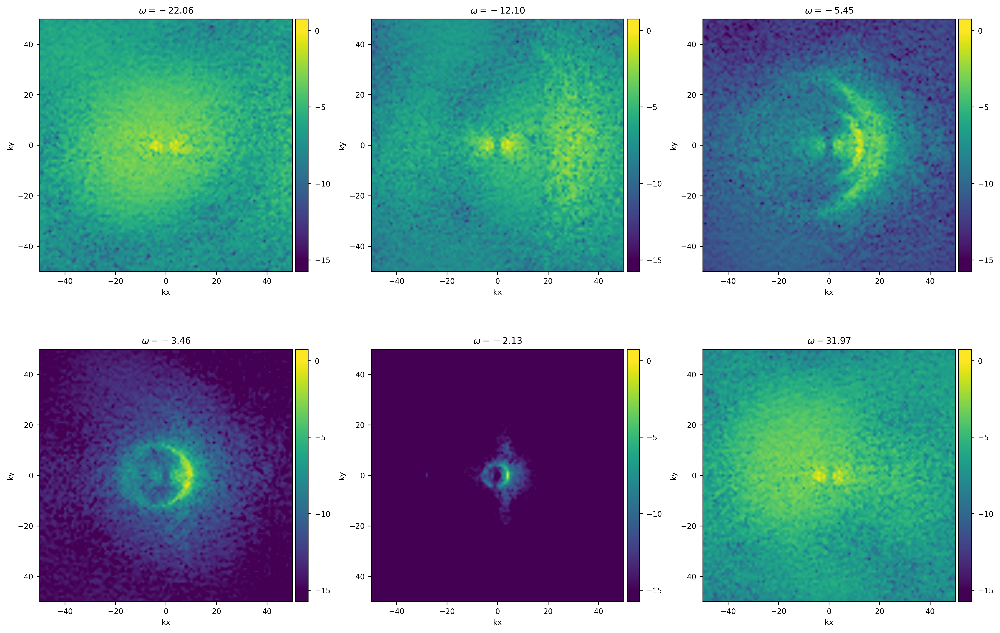

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from mpl_toolkits.axes_grid1 import make_axes_locatable

ind_time = [150, 300, 400, 430, 450, -1]
num_rows = 2
num_cols = 3

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))

j = 0

N = 512
L = 2 * np.pi

for i in ind_time:
    vmin = -15
    vmax = 0
    levels = np.linspace(vmin, vmax, 200)

    ax = axes[j // num_cols, j % num_cols]

    norm = np.max(F_3D[i])

    im = ax.contourf(
        kx_tile,
        ky_tile,
        np.log(F_xyomega[:, i] / np.max(F_xyomega[:, i])),
        levels=levels,
        extend="both",
    )

    ax.set_aspect("equal")
    ax.set_title(label=r"$\omega=%.2f$" % (omega[i]))
    ax.set_xlabel("kx")
    ax.set_ylabel("ky")
    ax.set_ylim([-50, 50])
    ax.set_xlim([-50, 50])

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    cbar = fig.colorbar(im, cax=cax, orientation="vertical", extendrect="False")

    # cbar = fig.colorbar(im, ax=axs, pad=0.04, orientation='vertical',  extendrect = 'False', shrink= 0.6)
    cbar.ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"${int(x)}$"))
    cbar.ax.yaxis.set_major_locator(plt.FixedLocator([-20, -15, -10, -5, 0]))

    j += 1

plt.tight_layout()
plt.show()

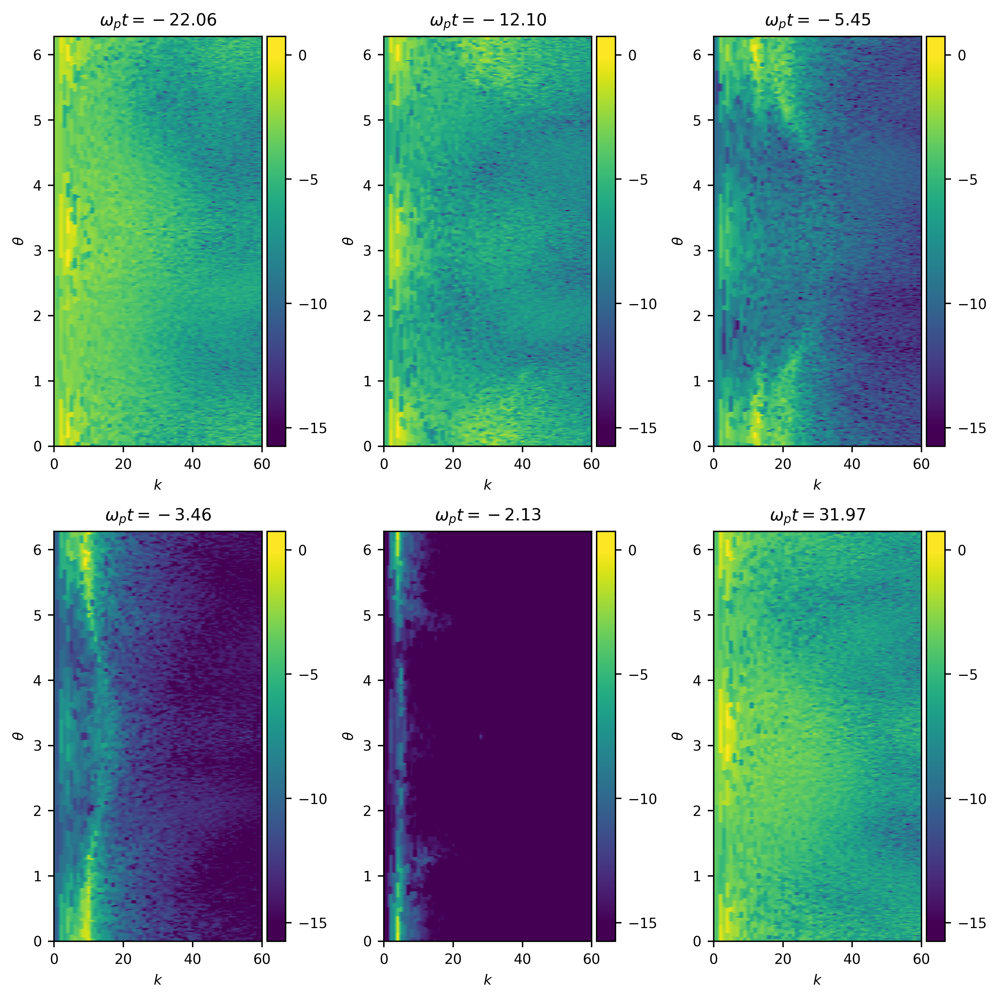

In [ ]:
num_rows = 2
num_cols = 3

fig, axes = plt.subplots(num_rows, num_cols, figsize=(8, 8))

j = 0

N = 512
L = 2 * np.pi

for i in ind_time:
    vmin = -15
    vmax = 0
    levels = np.linspace(vmin, vmax, 200)

    ax = axes[j // num_cols, j % num_cols]

    norm = np.max(F_kthetaomega[:, i])

    im = ax.contourf(
        k_tile,
        theta_tile,
        np.log(F_kthetaomega[:, i] / norm),
        levels=levels,
        extend="both",
    )

    ax.set_title(label=r"$\omega_{p} t=%.2f$" % (omega[i]))
    ax.set_xlabel("$k$")
    ax.set_ylabel(r"$ \theta $")
    ax.set_xlim([0, 100])

    cbar = fig.colorbar(im, ax=ax, orientation="vertical", pad=0.02, extendrect="False")
    cbar.ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"${int(x)}$"))
    cbar.ax.yaxis.set_major_locator(plt.FixedLocator([-20, -15, -10, -5, 0]))

    ax.set_xlim([0, 60])
    ax.set_xlabel("$k$")
    ax.set_ylabel(r"$ \theta $")

    j += 1

plt.tight_layout()
plt.show()

In [ ]:
fig = plt.figure(figsize=[3, 2])
ax = plt.gca()
# print(F_komega.shape)
norm = np.max(F_komega)


vmin = -20
vmax = 0
levels = np.linspace(vmin, vmax, 200)

# pa = plt.pcolormesh(k,omega,np.log(F_komega.T/norm),shading='nearest')#{'flat', 'nearest', 'gouraud', 'auto'}
pa = plt.contourf(k, omega, np.log(F_komega.T / norm), levels=levels, extend="both")

print(F_komega.shape)
omega_max = []
omega_maxsecond = []

for xk in indices:
    max_indexk = np.argmax(np.log(F_komega[int(xk), :]))
    omega_max.append(np.abs(omega[max_indexk]))

for xk in k_second:
    max_indexksecond = np.argmax(np.log(F_komega[int(xk), :]))
    omega_maxsecond.append(np.abs(omega[max_indexksecond]))


omega_max = np.array(omega_max)
filtered_coordx = np.array(indices)


omega_maxsecond = np.array(omega_maxsecond)
filtered_coordxsecond = np.array(k_second)

c = (9.8 * m.pi / 2 + 1 * 2 / (m.pi * 850)) ** 0.5
rho = 9.8
sigma = 1

# print('k value' , filtered_coordx,'omega value',omega_max,omega_max.shape)

# pu = plt.scatter(filtered_coordx  , np.array(omega_max),marker='o',s=2.5, c ='k', alpha = 0.7 , label = 'Bound modes')
# pu = plt.scatter(filtered_coordxsecond  , np.array(omega_maxsecond), marker="^" ,s=2.5, c ='r', alpha = 0.7, label = 'Free modes')

"""
pu = plt.axvline( x=4, ls = '--', c ='k', alpha = 0.5, lw=0.3)#, label = r"$k=4$")
pu = plt.axvline( x=8, ls = '--', c ='r', alpha = 0.5, lw=0.3)#, label = r"$k=8$")
pu = plt.axvline( x=12, ls = '--', c ='y', alpha = 0.5, lw=0.3)#, label = r"$k=12$")
pu = plt.axvline( x=16, ls = '--', c ='g', alpha = 0.5, lw=0.3)#, label = r"$k=16$")
"""

kp = 4
g = 1
lc = 0.44 / kp
omegap = (kp * g) ** 0.5
omega_lc = (2 * np.pi / lc * g + g / kp**2 / 200 * (2 * np.pi / lc) ** 3) ** 0.5


# plt.plot(filtered_coordx , (omega_max),':',lw=0.5, c ='k', alpha = 0.3)

# Perform linear regression
slope, intercept = np.polyfit(filtered_coordx[:3], omega_max[:3], deg=1)

# Plot the line
plt.plot(
    k,
    intercept + slope * k,
    "k",
    lw=0.5,
    alpha=0.3,
    label=r"$%.2f + %.2f \cdot k$" % (intercept, slope),
)


plt.plot(k, (k * g) ** 0.5, ":", lw=0.5, c="w", label=r"$\omega= \sqrt{gk}$")


cbar = fig.colorbar(im, ax=ax, orientation="vertical", pad=0.02, extendrect="False")
cbar.ax.yaxis.set_major_locator(MaxNLocator(integer=True))
cbar.ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"${int(x)}$"))
cbar.ax.yaxis.set_major_locator(plt.FixedLocator([-20, -15, -10, -5, 0]))


ak = 0.3
ustar_c = 0.5
B0 = 200


plt.ylabel("$\omega$", labelpad=0)
plt.xlabel("$k$", labelpad=0)
plt.legend(loc="upper right", fontsize=4)
ax.set_xlim([0, 16])
ax.set_ylim([0, 16])
# title = r"$ak = {:.1f} \quad u^*/c = {:.1f} \quad B0 = {:.0f}$".format(ak, ustar_c, B0)
# ax.set_title(title, fontsize=5, fontweight='bold')

# cbaxes = fig.add_axes([0.4, -0.2, 0.5, 0.04])
# These are in unitless percentages of the figure size. (0,0 is bottom left)
left, bottom, width, height = [1.02, 0.58, 0.4, 0.3]
ax2 = fig.add_axes([left, bottom, width, height])


ratio = omega_max / filtered_coordx

ratio_second = omega_maxsecond / filtered_coordxsecond
# print('k value' , filtered_coordx.shape,'omega value',omega_max, 'ratio', ratio.shape)

ax2.plot(filtered_coordx, ratio, "o-", c="k", alpha=0.7)
ax2.plot(k_second, ratio_second, "^-", c="r", alpha=0.7)
ax2.set_ylim([0, 1])
ax2.set_ylabel("$\omega / k$", labelpad=0)
ax2.set_xlabel("$k$", labelpad=0)
ax2.grid(True)

/tmp/ipykernel_489845/2568198857.py:11: RuntimeWarning: divide by zero encountered in log
  pa = plt.contourf(k, omega, np.log(F_komega.T/norm), levels=levels, extend='both')


(256, 964)


/tmp/ipykernel_489845/576923341.py:22: UserWarning: Z contains NaN values. This may result in rendering artifacts.
  surf = ax.plot_surface(k_filtered, omega_filtered, (F_komega_filtered), alpha=0.9,cmap='viridis', rstride=1, cstride=1 , vmin=-40, vmax=-20)


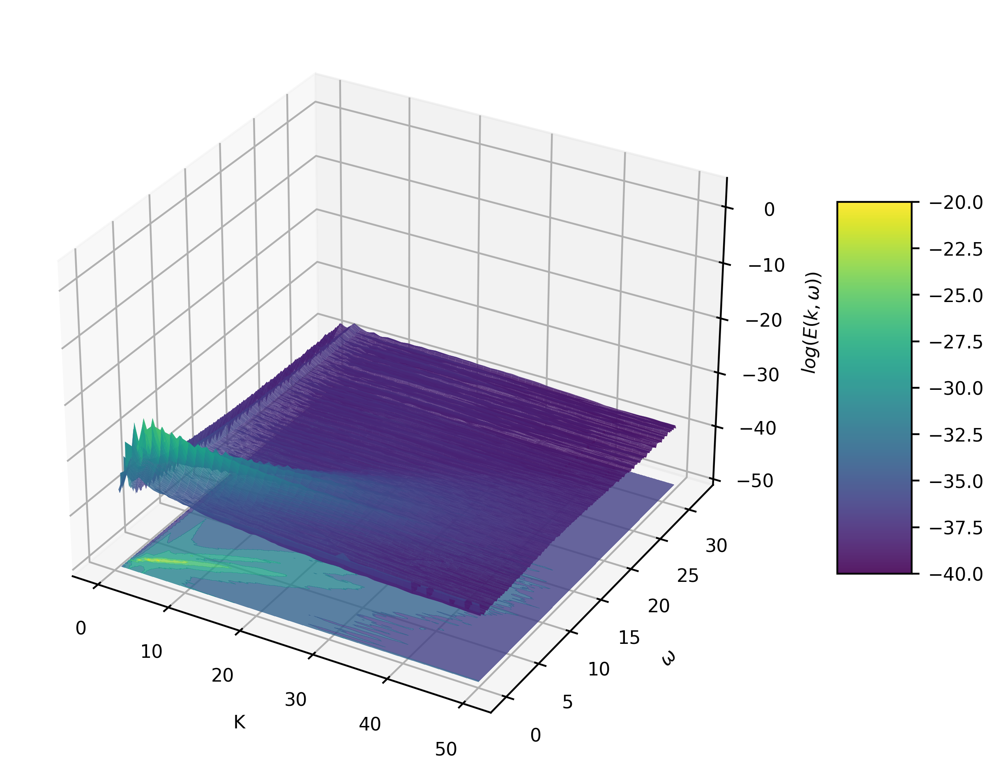

In [ ]:
# plot in function of capillary length lc

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import colors

fig = plt.figure(figsize=(12, 6))

ax = fig.add_subplot(111, projection="3d")
rango = (0, 50)

# Filtrar los valores de K, Omega y F_komega dentro del rango deseado
k_filtered = np.where((K >= rango[0]) & (K <= rango[1]), K, np.nan)
omega_filtered = np.where((Omega >= rango[0]) & (Omega <= rango[1]), Omega, np.nan)
# F_komega_filtered = np.where((K >= rango[0]) & (K <= rango[1]) & (Omega >= rango[0]) & (Omega <= rango[1]), np.log(F_komega), np.nan)
F_komega_filtered = np.where(
    (K >= rango[0]) & (K <= rango[1]) & (Omega >= rango[0]) & (Omega <= rango[1]),
    np.log(np.where(F_komega > 0, F_komega, np.nan)),
    np.nan,
)

# Crear la superficie 3D
norm = np.max(F_komega_filtered)
cset = ax.contourf(
    k_filtered,
    omega_filtered,
    (F_komega_filtered),
    zdir="z",
    offset=-50,
    alpha=0.8,
    cmap="viridis",
)
surf = ax.plot_surface(
    k_filtered,
    omega_filtered,
    (F_komega_filtered),
    alpha=0.9,
    cmap="viridis",
    rstride=1,
    cstride=1,
    vmin=-40,
    vmax=-20,
)

fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5)
ax.set_xlabel("K")
ax.set_ylabel("$\omega$")
ax.set_zlabel("$log(E(k,\omega))$")
ax.set_zlim(-50, 4)

plt.show()